### AU565 Live Cell Images Segmentation

This notebook intiates processing of AU565 movies. The experiment was run in 6 24-well plates and imaged with the Incucyte microscope. The experiment ran for 4 days and was imaged every 30 minutes. Phase contrast and two fluorescent channels were recorded.

In [1]:
#setup libraries
import os, re, sys, glob, shutil
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mahotas as mh
from skimage import io, filters, segmentation, morphology, measure
from cellpose import models, plot
from scipy import stats
from pystackreg import StackReg

use_GPU = models.use_gpu()
print('>>> GPU activated? %d'%use_GPU)

2021-07-09 09:36:14,317 [INFO] WRITING LOG OUTPUT TO /home/users/dane/.cellpose/run.log
2021-07-09 09:36:21,529 [INFO] ** TORCH CUDA version installed and working. **
>>> GPU activated? 1


In [15]:
pipeline_name = 'CL'
ch1_name = 'NR'
ch2_name = 'CC'
cyto_expansion = 5
#starting with one field, read in the nuclear reporter images and sort them by time
data_path = '/home/exacloud/gscratch/HeiserLab/images/'
plateID = 'AU01401'
well = 'C2'
field = '4'

In [16]:
data_paths =glob.glob(os.path.join(data_path+plateID+'/'+well+'/','field_'+field+'/*_R_*m.tif'))
df = pd.DataFrame(data_paths, columns =['path']).sort_values(by='path', ignore_index = True)

In [9]:
#call cellpose on each image to segment the nuclei
# DEFINE CELLPOSE MODEL
# model_type='cyto' or model_type='nuclei'
model = models.Cellpose(gpu=use_GPU, model_type='cyto2')

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
channels = [0,0]

2021-07-09 09:39:24,306 [INFO] ** TORCH CUDA version installed and working. **
2021-07-09 09:39:24,308 [INFO] >>>> using GPU


In [19]:
ind = 162
path_name = df['path'][ind]
path_name_p = str.replace(path_name, '_R_', '_P_')
path_name_g = str.replace(path_name, '_R_', '_G_')

# load the image of the red nuclear channel and run a smoothing filter
image_r = io.imread(path_name)
image_rf = filters.median(image_r, selem=morphology.disk(2))

# load the phase image for display purposes
image_p = io.imread(path_name_p)

# load the green image for display purposes
image_g = io.imread(path_name_g)

#Combine phase and nuclear images with nuceli in R 1 channel and phase in G 2 channel
image = np.dstack([image_rf, image_p])

# create masks with cellpose using only nulcelar channel
masks, flows, styles, diams = model.eval(image_rf, diameter=None, flow_threshold=.4, cellprob_threshold=0.0, channels=channels, min_size=125, resample = False)
masks.max()

2021-07-09 09:42:47,145 [INFO] ~~~ ESTIMATING CELL DIAMETER(S) ~~~
2021-07-09 09:42:50,698 [INFO] estimated cell diameter(s) in 3.55 sec
2021-07-09 09:42:50,699 [INFO] >>> diameter(s) = 
2021-07-09 09:42:50,700 [INFO] [ 20.06 ]
2021-07-09 09:42:50,702 [INFO] ~~~ FINDING MASKS ~~~


/home/exacloud/gscratch/HeiserLab/software/miniconda3/envs/biapy/lib/python3.7/site-packages/torch/nn/functional.py:3829: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  "Default grid_sample and affine_grid behavior has changed "


2021-07-09 09:42:58,738 [INFO] >>>> TOTAL TIME 11.59 sec


667

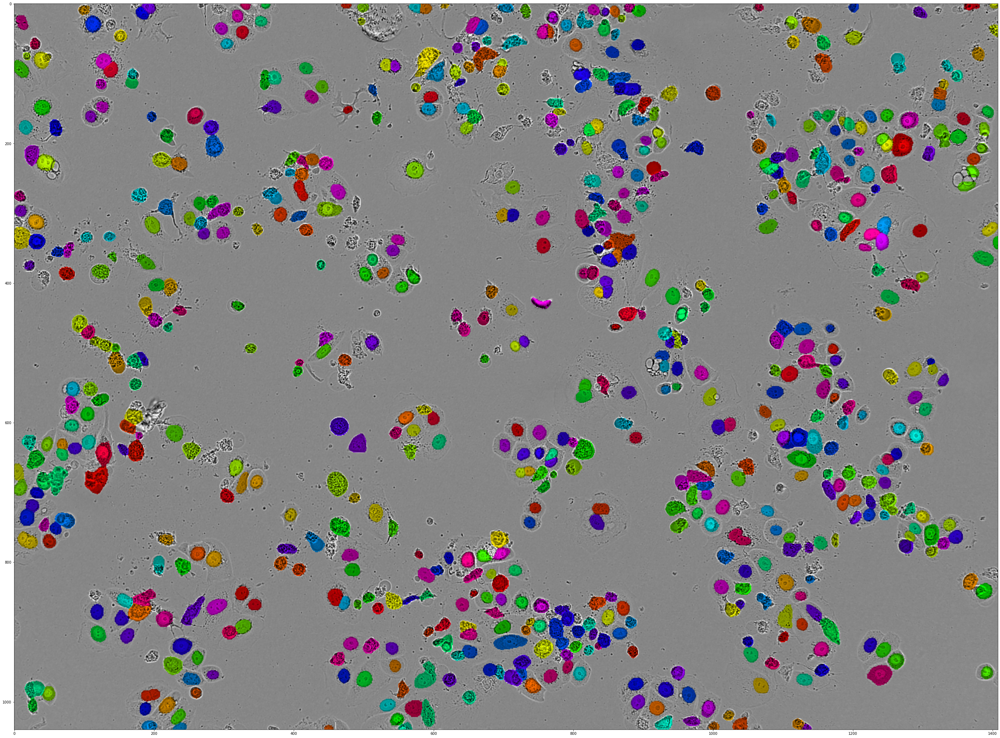

In [20]:
masks_o = plot.mask_overlay(image, masks, colors=None)
#Save mask overlay image
mask_filename = path_name.replace(".tif", "_mask_overlay.png")
io.imsave(mask_filename, masks_o)

fig, ax = plt.subplots(figsize=(50,50))
ax.imshow(masks_o, cmap = 'gray');


In [7]:
#Save mask image
mask_filename = path_name.replace(".tif", "_masks.png")
io.imsave(mask_filename, masks)

/home/exacloud/gscratch/HeiserLab/software/miniconda3/envs/biapy/lib/python3.7/site-packages/ipykernel_launcher.py:3: UserWarning: /home/exacloud/gscratch/HeiserLab/images/AU01101/A1/field_1/AU01101_R_A1_1_02d02h03m_masks.png is a low contrast image
  This is separate from the ipykernel package so we can avoid doing imports until


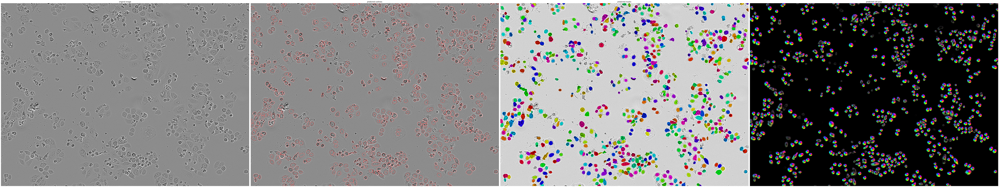

In [25]:
fig = plt.figure(figsize=(100,40))
plot.show_segmentation(fig, image_p, masks, flows[0])
plt.tight_layout()

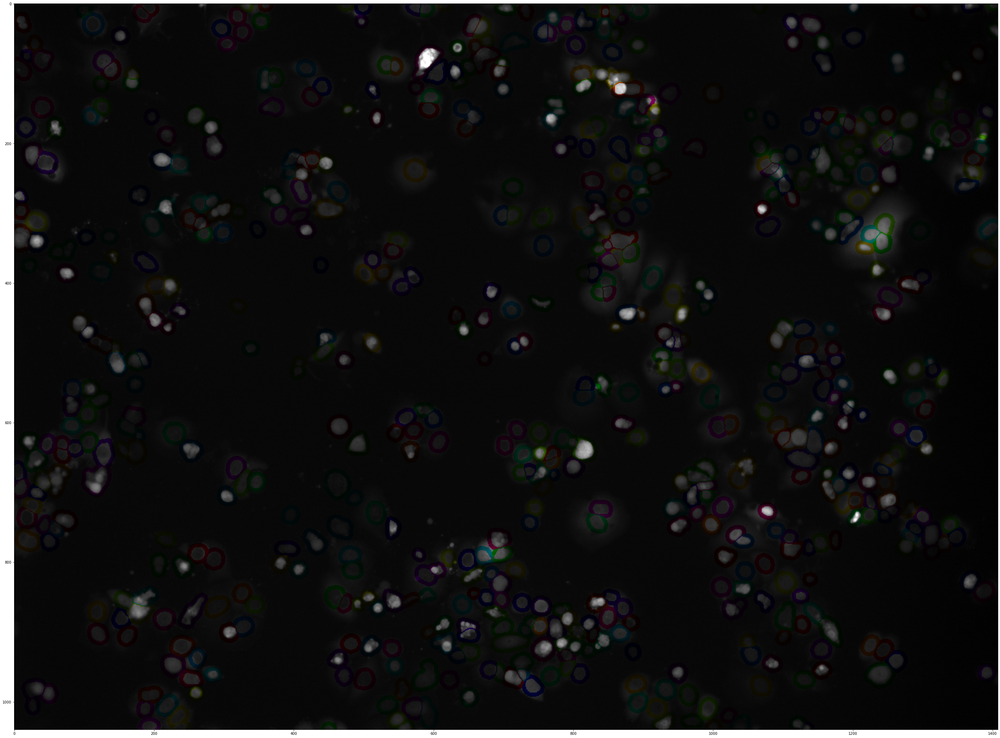

In [26]:
#expand the masks to get cytoplasmic regions
nuclei_boundaries = segmentation.find_boundaries(masks, mode='thick')*masks
nuclei_expansions = segmentation.expand_labels(masks, cyto_expansion) - masks + nuclei_boundaries

masks_o = plot.mask_overlay(image_g, nuclei_expansions, colors=None)

fig, ax = plt.subplots(figsize=(50,50))
ax.imshow(masks_o, cmap = 'gray');

In [70]:
def intensity_std(regionmask, intensity_image):
    return np.std(intensity_image)

def measure_shannon_entropy(regionmask, intensity_image):
    return measure.shannon_entropy(intensity_image)


def measure_haralick(regionmask, intensity_image):
    return mh.features.haralick(intensity_image).mean(0)

def measure_hu_moments(regionmask, intensity_image):
    return measure.moments_hu(intensity_image)

#measure nuclear intensity, nuclear morphology and texture in the red channel
nuclei = measure.regionprops_table(measure.label(masks), intensity_image=image_rf,
                                           properties=('label',
                                                       'area','bbox','bbox_area','convex_area','centroid','eccentricity','equivalent_diameter','extent','feret_diameter_max','filled_area',
                                                        'major_axis_length','minor_axis_length','perimeter','perimeter_crofton','solidity',
                                                        'mean_intensity','max_intensity','min_intensity',),
                                   extra_properties=(intensity_std, measure_shannon_entropy))

#measure cytoplasmic intensity of the cell cycle reporter
nuclei_exp = measure.regionprops_table(measure.label(nuclei_expansions), intensity_image=image_g,
                                           properties=('label',
                                                        'mean_intensity','max_intensity','min_intensity'),
                                   extra_properties=(intensity_std, measure_shannon_entropy))

#measure nuclear intensity, morphology and texture in the phase images
nuclei_p = measure.regionprops_table(measure.label(masks), intensity_image=image_p,
                                           properties=('label',
                                                        'mean_intensity','max_intensity','min_intensity'),
                                   extra_properties=(intensity_std, measure_shannon_entropy))
# turn results into a dataframe
nuclei_data = pd.DataFrame(nuclei)
nuclei_data.rename(columns={col: 'Nuclei_'+pipeline_name+'_' +ch1_name+'_'+col  for col in nuclei_data.columns if col not in ['label']}, inplace=True)
   
nuclei_p_data = pd.DataFrame(nuclei_p)
nuclei_p_data.rename(columns={col: 'Nuclei_'+pipeline_name+'_' +'phase'+'_'+col  for col in nuclei_p_data.columns if col not in ['label']}, inplace=True)
    
nuclei_exp_data = pd.DataFrame(nuclei_exp)
nuclei_exp_data.rename(columns={col: 'Cyto_'+pipeline_name+'_' +ch2_name+'_'+col  for col in nuclei_exp_data.columns if col not in ['label']}, inplace=True)
    
#concatenate the dataframes from the different channels
single_image_data = pd.concat([nuclei_data, nuclei_p_data, nuclei_exp_data], axis=1, join="inner")
single_image_data

mainpath = '../../../images/'+plateID+'/Analysis/CL/'
if not os.path.exists(mainpath):
    os.makedirs(mainpath, exist_ok=True)
    
single_image_data.to_csv(mainpath+plateID+'_'+well+'_'+field+'_'+str(ind)+'_data.csv')
                         

Register a stack using the nuclear channel, save the transformations and apply them to the other channels.

In [136]:
well = 'A1'
field = 'field_1'
r_data_paths = glob.glob(os.path.join(data_path+plateID+'/'+well+'/','field_1/',"*_R_*m.tif"))
img_r_ic = io.imread_collection(r_data_paths) # 3 dimensions : frames x width x height
img_r = np.stack(img_r_ic)

#load and prepare green and phase channels
g_data_paths = glob.glob(os.path.join(data_path+plateID+'/'+well+'/','field_1/',"*_G_*m.tif"))
img_g_ic = io.imread_collection(g_data_paths) # 3 dimensions : frames x width x height
img_g = np.stack(img_g_ic)

p_data_paths = glob.glob(os.path.join(data_path+plateID+'/'+well+'/','field_1/',"*_P_*m.tif"))
img_p_ic = io.imread_collection(p_data_paths) # 3 dimensions : frames x width x height
img_p = np.stack(img_p_ic)

# stacks must have the same shape
#assert img0.shape == img1.shape

sr = StackReg(StackReg.TRANSLATION)

# register each frame
reg_reference = 'previous'
tmats = sr.register_stack(img_r, reference=reg_reference,axis=0)
img_r_reg = sr.transform_stack(img_r, tmats=tmats)
img_g_reg = sr.transform_stack(img_g, tmats=tmats)
img_p_reg = sr.transform_stack(img_p, tmats=tmats)

r_filename = data_path+plateID+'/'+well+'/'+field+'/registered_stacks/'+well+'_'+field+'_R_'+reg_reference+'.tif'
if not os.path.exists(data_path+plateID+'/'+well+'/'+field+'/registered_stacks/'):
        os.makedirs(data_path+plateID+'/'+well+'/'+field+'/registered_stacks/')
io.imsave(r_filename, img_r_reg,plugin='tifffile')
np.save(data_path+plateID+'/'+well+'/'+field+'/registered_stacks/'+plateID+'_'+well+'_'+field+'_R_'+reg_reference+'_transformation_matrices.npy', tmats)


In [11]:
flow_threshold = .4
diameter = 16
cellprob_threshold=0.0
min_size=125
resample = True

In [24]:
results = []
#Segment using the nuclear signal in the grayscale image from the red channel

# create an index that allows us to go through each pair of images
for path_name in df['path'][0:1]:
    path_name_p = str.replace(path_name, '_R_', '_P_')
    path_name_g = str.replace(path_name, '_R_', '_G_')
    
    # load the image of the red nuclear channel and run a smoothing filter
    image_r = io.imread(path_name)
    image_rf = filters.median(image_r, selem=morphology.disk(2))
    
    # load the phase image for display purposes
    image_p = io.imread(path_name_p)

    # load the phase image for display purposes
    image_g = io.imread(path_name_g)

    #Combine phase and nuclear images with nuceli in R 1 channel and phase in G 2 channel
    #image = np.dstack([image_rf, image_p])

    # create masks with cellpose 
    masks, flows, styles, diams = model.eval(image_rf, diameter=diameter, flow_threshold=flow_threshold, cellprob_threshold=cellprob_threshold, channels=channels, min_size=min_size, resample = resample)

    #measure reporter intensity and nuclear morphology, texture
    nuclei = measure.regionprops_table(measure.label(masks), intensity_image=image_r,
                                           properties=('label',
                                                       'area','bbox_area','convex_area','centroid','eccentricity','equivalent_diameter','extent','feret_diameter_max','filled_area',
                                                        'major_axis_length','minor_axis_length','moments_hu','perimeter','perimeter_crofton','solidity',
                                                        'mean_intensity','max_intensity','min_intensity'))
    #Save mask image
    mask_filename = path_name.replace(".tif", "_masks.png")
    io.imsave(mask_filename, masks)
    
    #expand the masks to get cytoplasmic regions
    nuclei_boundaries = segmentation.find_boundaries(masks, mode='thick')*masks
    nuclei_expansions = segmentation.expand_labels(masks, cyto_expansion) - masks + nuclei_boundaries
    
    # measure nuclear and cytoplasmic intensities and textures in the green channel
    nuclei_g = measure.regionprops_table(measure.label(masks), intensity_image=image_g,
                                           properties=('label',
                                                        'mean_intensity','max_intensity','min_intensity'))
    nuclei_exp_g = measure.regionprops_table(measure.label(nuclei_expansions), intensity_image=image_g,
                                                 properties=('label',
                                                             'mean_intensity','max_intensity','min_intensity'))
    
    # turn results into a dataframe
    nuclei_data = pd.DataFrame(nuclei)
    nuclei_data.rename(columns={col: 'Nuclei_'+pipeline_name+'_' +ch1_name+'_'+col  for col in nuclei_data.columns if col not in ['label']}, inplace=True)
   
    nuclei_g_data = pd.DataFrame(nuclei_g)
    nuclei_g_data.rename(columns={col: 'Nuclei_'+pipeline_name+'_' +ch2_name+'_'+col  for col in nuclei_g_data.columns if col not in ['label']}, inplace=True)
    

    nuclei_exp_g_data = pd.DataFrame(nuclei_exp_g)
    nuclei_exp_g_data.rename(columns={col: 'Cyto_'+pipeline_name+'_' +ch2_name+'_'+col  for col in nuclei_exp_g_data.columns if col not in ['label']}, inplace=True)
       
    # recover the well and field values and add them to the dataframe
    well = re.findall('_[A-Z][0-9]+_',path_name)[0]
    well = re.sub('_','', well)
    nuclei_data['well'] = well
    field = re.findall('_[0-9]+_',path_name)[0]
    field = re.sub('_','', field)
    nuclei_data['field'] = field
    time_slice = re.findall('[a-z0-9]*.tif',path_name)[0]
    time_slice = re.sub('.tif','', time_slice)
    nuclei_data['time'] = time_slice
    
    #Calculate ratio of ch2 cyto to nuclei intensities
    nuclei_exp_g_data['Cell_'+pipeline_name+'_' +ch2_name+'_mean_intensity_ratio'] = nuclei_exp_g_data['Cyto_'+pipeline_name+'_' +ch2_name+'_mean_intensity']/nuclei_g_data['Nuclei_'+pipeline_name+'_' +ch2_name+'_mean_intensity']
    nuclei_exp_g_data['Cell_'+pipeline_name+'_' +ch2_name+'_max_intensity_ratio'] = nuclei_exp_g_data['Cyto_'+pipeline_name+'_' +ch2_name+'_max_intensity']/nuclei_g_data['Nuclei_'+pipeline_name+'_' +ch2_name+'_max_intensity']
    nuclei_exp_g_data['Cell_'+pipeline_name+'_' +ch2_name+'_min_intensity_ratio'] = nuclei_exp_g_data['Cyto_'+pipeline_name+'_' +ch2_name+'_min_intensity']/nuclei_g_data['Nuclei_'+pipeline_name+'_' +ch2_name+'_min_intensity']

    #concatenate the dataframes from the different channels
    df_all = pd.concat([nuclei_data, nuclei_g_data, nuclei_exp_g_data], axis=1, join="outer")
    # append the dataframe to the results list
    results.append(df_all)
    print("processing "+path_name)
    

2021-06-28 15:16:28,180 [INFO] ~~~ FINDING MASKS ~~~
2021-06-28 15:16:32,461 [INFO] >>>> TOTAL TIME 4.28 sec


/home/exacloud/gscratch/HeiserLab/software/miniconda3/envs/biapy/lib/python3.7/site-packages/ipykernel_launcher.py:33: UserWarning: /home/exacloud/gscratch/HeiserLab/images/AU01101/A1/field_1/AU01101_R_A1_1_00d00h00m_masks.png is a low contrast image


processing /home/exacloud/gscratch/HeiserLab/images/AU01101/A1/field_1/AU01101_R_A1_1_00d00h00m.tif


In [25]:
#concatenate all of the results
all_results = pd.concat(results)
all_results

,label,Nuclei_CL_NR_area,Nuclei_CL_NR_bbox_area,Nuclei_CL_NR_convex_area,Nuclei_CL_NR_centroid-0,Nuclei_CL_NR_centroid-1,Nuclei_CL_NR_eccentricity,Nuclei_CL_NR_equivalent_diameter,Nuclei_CL_NR_extent,Nuclei_CL_NR_feret_diameter_max,...,Nuclei_CL_CC_mean_intensity,Nuclei_CL_CC_max_intensity,Nuclei_CL_CC_min_intensity,label,Cyto_CL_CC_mean_intensity,Cyto_CL_CC_max_intensity,Cyto_CL_CC_min_intensity,Cell_CL_CC_mean_intensity_ratio,Cell_CL_CC_max_intensity_ratio,Cell_CL_CC_min_intensity_ratio
0,1,172,224,179,6.203488,1294.186047,0.552844,14.798554,0.767857,17.088007,...,238.186047,266,194,1,297.230769,548,205,1.247893,2.060150,1.056701
1,2,195,256,201,9.082051,629.112821,0.510131,15.756958,0.761719,17.888544,...,467.892308,562,338,2,259.797386,378,203,0.555250,0.672598,0.600592
2,3,417,552,428,16.182254,759.026379,0.571156,23.042155,0.755435,26.400758,...,386.417266,455,275,3,213.266667,264,172,0.551908,0.580220,0.625455
3,4,250,300,260,15.664000,735.164000,0.633164,17.841241,0.833333,20.880613,...,493.768000,878,222,4,230.706271,306,205,0.467236,0.348519,0.923423
4,5,183,240,188,15.704918,1327.273224,0.616149,15.264430,0.762500,17.888544,...,249.994536,277,212,5,202.532915,277,161,0.810149,1.000000,0.759434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254,255,158,195,164,1021.879747,291.322785,0.442185,14.183506,0.810256,15.811388,...,568.386076,870,245,255,323.465116,631,208,0.569094,0.725287,0.848980
255,256,140,169,146,1020.850000,317.542857,0.358063,13.351162,0.828402,14.764823,...,662.507143,928,327,256,505.627072,770,216,0.763202,0.829741,0.660550
256,257,195,252,203,1021.758974,728.358974,0.650903,15.756958,0.773810,18.973666,...,528.666667,756,418,257,467.971751,940,215,0.885192,1.243386,0.514354
257,258,169,221,177,1027.917160,358.313609,0.634289,14.668929,0.764706,17.464249,...,470.112426,540,280,258,353.153226,526,202,0.751210,0.974074,0.721429


In [32]:
mainpath = '../../../images/'+plateID+'/Analysis/CL/'
if not os.path.exists(mainpath):
    os.makedirs(mainpath, exist_ok=True)
all_results.to_csv(mainpath+plateID+'_'+well+'_level_0.csv')